In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
import os
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

In [2]:
from utils import COLUMNS, FONT_FAMILY

In [3]:
np.random.seed(2603)
pd.set_option("display.max_columns", None)

# Import data

The dataset loaded is a simple merge of all raw data files.<br>
See readme file for more info about the raw data files.

In [4]:
data_dir = 'artifacts'

In [5]:
data = pd.read_csv(os.path.join(data_dir, 'fifa_full_data.csv'))
print('Raw dataset:')
print(data.shape)
print('unique players ids:', len(data[COLUMNS.PLAYER_ID].unique()))
print('unique clubs ids:', len(data['club_team_id'].unique()))
print('unique players urls:', len(data['player_url'].unique()))
print('unique players long names:', len(data[COLUMNS.PLAYER_FULL_NAME].unique()))

Raw dataset:
(160618, 118)
unique players ids: 45630
unique clubs ids: 1017
unique players urls: 160499
unique players long names: 55376


In [6]:
data.year.min(), data.year.max()

(15, 23)

### Some pre-calculations to serve us later
Same processing as applied in chapter 1. I decided to replicate it here for clarity and context.

In [7]:
# Seasons count per player
players_seasons_count = data[[COLUMNS.PLAYER_ID, 'player_url']].groupby(COLUMNS.PLAYER_ID).count().reset_index()
players_seasons_count.columns = [COLUMNS.PLAYER_ID, 'num_seasons']

# Max price per player
PRICE_COL = COLUMNS.PLAYER_VALUE
max_price_per_player = data[[COLUMNS.PLAYER_ID, PRICE_COL]].groupby(COLUMNS.PLAYER_ID).max()\
                        .to_dict(orient='index')
max_price_per_player = {k: v[PRICE_COL] for k,v in max_price_per_player.items()}

# Max performance
# Normaliza prices by player max value
max_overall_per_player = data[[COLUMNS.PLAYER_ID, 'overall']].groupby(COLUMNS.PLAYER_ID).max()\
                        .to_dict(orient='index')
max_overall_per_player = {k: v['overall'] for k,v in max_overall_per_player.items()}
max_potential_per_player = data[[COLUMNS.PLAYER_ID, 'potential']].groupby(COLUMNS.PLAYER_ID).max()\
                        .to_dict(orient='index')
max_potential_per_player = {k: max(v['potential'], max_overall_per_player[k]) for k,v in max_potential_per_player.items()}

In [8]:
data_over2seasons = set(players_seasons_count.loc[players_seasons_count['num_seasons'] > 2,  COLUMNS.PLAYER_ID].unique().tolist())
print('Number of players with more than 1 year of data:' ,len(data_over2seasons))

Number of players with more than 1 year of data: 21505


In [9]:
# Filter data to players with > 1 years of data
data = data[data[COLUMNS.PLAYER_ID].isin(data_over2seasons)].sort_values(by=[COLUMNS.PLAYER_ID,
                                                                            'year'], 
                                                                              ascending=True)
# Add potential-overall-ratio
data[COLUMNS.POTENTIAL_RATIO] = data[COLUMNS.PLAYER_RATING] / data['potential']
relevant_numeric_cols = [c for c in data.select_dtypes(np.number).columns]
data = data.reset_index()

# Add new position column - using the positions_mapper
# Normaliza prices by player max value
data[f'normed_{PRICE_COL}'] = data.apply(lambda x: 
                                         round(100*x[PRICE_COL]/max_price_per_player[x[COLUMNS.PLAYER_ID]], 2), axis=1)
data[f'normed_{COLUMNS.PLAYER_RATING}'] = data.apply(lambda x: round(x[COLUMNS.PLAYER_RATING] / max_potential_per_player[x[COLUMNS.PLAYER_ID]], 3)
                                         if not pd.isna(x[COLUMNS.PLAYER_RATING]) else x, axis=1)
# Add potential-overall-ratio
data[COLUMNS.POTENTIAL_RATIO] = data.apply(lambda x: round(x[COLUMNS.PLAYER_RATING] / max_potential_per_player[x[COLUMNS.PLAYER_ID]], 3)
                                         if not pd.isna(x[COLUMNS.PLAYER_RATING]) else x, axis=1)
data[COLUMNS.POTENTIAL_PERCENT] = data[COLUMNS.POTENTIAL_RATIO] * 100

In [10]:
print(data.shape)
print('unique players ids:', len(data[COLUMNS.PLAYER_ID].unique()))
print('unique clubs ids:', len(data['club_team_id'].unique()))
print('unique players long names:', len(data[COLUMNS.PLAYER_FULL_NAME].unique()))

(109573, 123)
unique players ids: 21505
unique clubs ids: 1012
unique players long names: 21980


# Player Valuation

In [11]:
data.head(1)

,index,Unnamed: 0,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,year,Best Position,National Team Name,Attacking Work Rate,Defensive Work Rate,LWB Rating,RWB Rating,potential-overall-ratio,normed_value_eur,normed_overall,potential-overall-%
0,115913,4669,16.0,https://sofifa.com/player/16/luis-garcia-ferna...,Luis García,Luis García Fernández,"CM, CAM, ST, RM",70,70,450000.0,8000.0,35,1981-02-06,177,69,2013.0,KAS Eupen,Belgian Jupiler Pro League,1.0,LCM,10.0,NaN,2014-07-19,2018.0,45.0,Spain,NaN,NaN,NaN,Right,3,3,1,Medium/Medium,Lean (170-185),No,NaN,NaN,Playmaker (AI),61.0,68.0,71.0,70.0,48.0,63.0,69,66,61,72,68,70,76,73,71,73,62,60,67,65,72,71,66,67,60,68,67,63,72,69,75,75.0,37,46,42,9,12,13,11,11,NaN,67+1,67+1,67+1,69,69,69,69,69,69+1,69+1,69+1,69+1,69+1,69+1,69+1,69+1,61+1,61+1,61+1,61+1,61+1,58+1,55+1,55+1,55+1,58+1,17+1,https://cdn.sofifa.net/players/000/016/17_120.png,https://cdn.sofifa.net/teams/2013/60.png,https://cdn.sofifa.net/flags/be.png,NaN,https://cdn.sofifa.net/flags/es.png,17,NaN,NaN,NaN,NaN,NaN,NaN,1.0,78.26,1.0,100.0


## 1 Factors analysis

- club_position - player playing position
- Club coefficient- Eg athletico and Barca - team rating / price multiplier vs rest of clubs in league (if no league - global mean)
- Overall transfer inflation - trend of team salary out of budget / average transfer fee this year / average player value in league /

- League coefficient - average team value in league, % of gold players from league
- Position coefficient
- Percentile of overall rating and potential
- Nationality coefficient - how this nationality label mean bigger than general average

In [12]:
league2nation = data[['league_name', 'nationality_name', COLUMNS.PLAYER_ID]].groupby(['league_name', 'nationality_name']).count().reset_index()\
    .sort_values(by=COLUMNS.PLAYER_ID, ascending=False)\
    .drop_duplicates(subset=['league_name'], keep='first').set_index('league_name')['nationality_name'].to_dict()

In [13]:
data['years_left_in_contract'] = data['club_contract_valid_until'].astype(float) - data['year'] - 2000
data['years_left_in_contract'] = data['years_left_in_contract'].apply(lambda x: max(0, x))
data['in_national_team'] = data['nation_position'].notna().astype(int)
data['play_in_based_nation'] = (data['nationality_name']==data['league_name'].map(league2nation)).astype(int)
print('Filtering data of players above age 36')
print(' - shape before:', len(data))
data = data[data['age'] <= 36]
print(' - shape after:', len(data))

Filtering data of players above age 36
 - shape before: 109573
 - shape after: 108599


In [14]:
data_2022 = data[data['year']==22].copy()

In [15]:
data_2022.shape

(12220, 126)

In [16]:
global_avg = data.groupby('year')[COLUMNS.PLAYER_VALUE].mean().to_dict()

In [17]:
global_avg

{15: 1402919.5573328373,
 16: 2103703.2198246797,
 17: 2290811.3035551505,
 18: 2780009.6835788325,
 19: 2813723.0071980804,
 20: 2921881.840385504,
 21: 3737738.9638145776,
 22: 3947492.4024640657}

<div class="alert alert-block alert-info"> <b>NOTE</b> From now on we continue without 2022, which be used as evaluation set. </div>

### Calculate the averages of players grouped by different factors' levels

In [18]:
multipliers = {}
mult_columns = ['age', 'league_name', 'league_level', 'club_name', 'club_position', 'nationality_name', 'play_in_based_nation',
                'in_national_team', 'international_reputation', 'years_left_in_contract', 'overall', 'potential']

for col in mult_columns:
    grouped_data = data[[col, 'year', COLUMNS.PLAYER_VALUE]].groupby(by=['year', col]).agg(
        [np.size, np.mean, np.median, np.std]).to_dict()
    multipliers[col] = grouped_data

### Checking the signal categorical factors with box plots

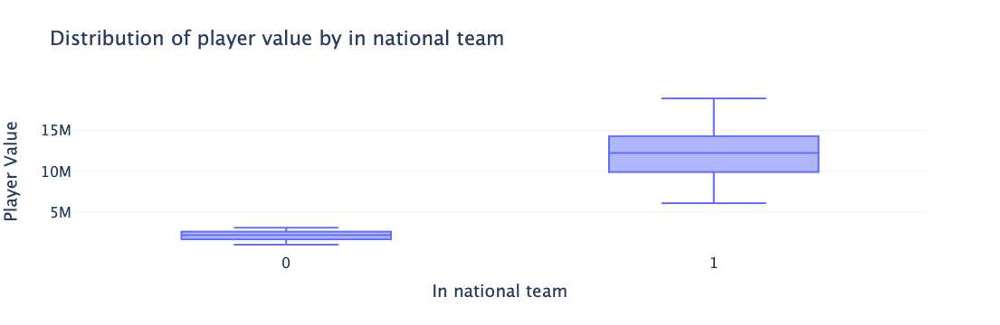

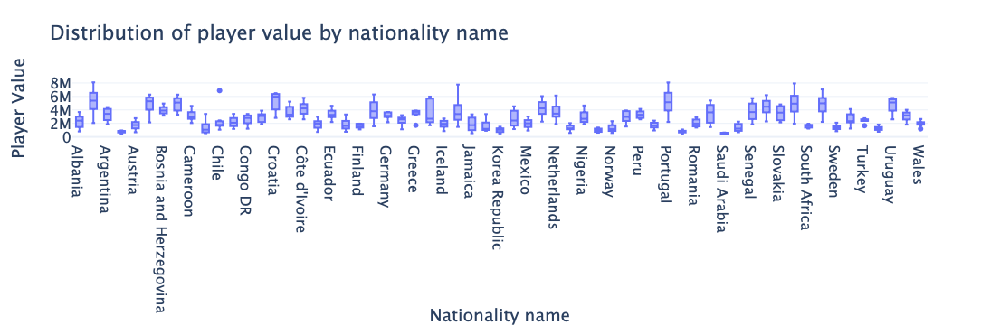

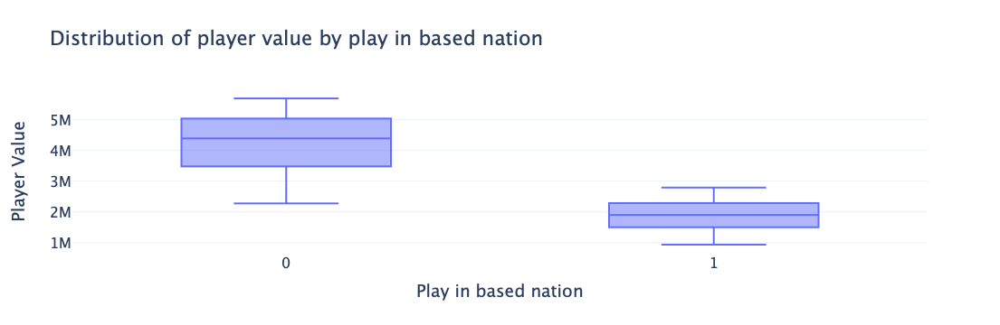

In [19]:
# Plot
for attr in ['in_national_team', 'nationality_name', 'play_in_based_nation']:
    attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
    attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']
      
    # Filter by min count
    cats_with_low_count = set(attr_df.loc[attr_df['player_count'] < 20, attr].tolist())
    attr_df = attr_df[~attr_df[attr].isin(cats_with_low_count)]
    fig = px.box(attr_df, x=attr, y='avg_value', 
                 title=f"Distribution of player value by {attr.replace('_', ' ')}")
    fig.update_layout(
    template='plotly_white',
    xaxis_title=attr.capitalize().replace('_', ' '),
    yaxis_title='Player Value',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
    fig.show()

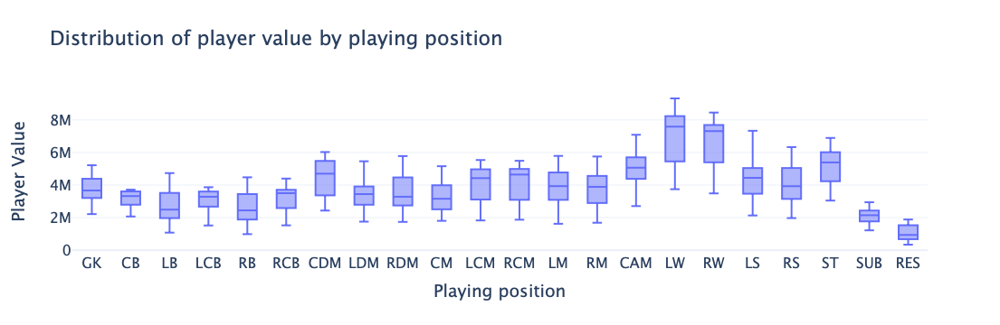

In [20]:
# Plot positions
attr =  'club_position'
attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']

category_orders = {"club_position": [
    # Back / def
    'GK', 'CB', 'LB', 'LCB', 'RB', 'RCB', 
    # midfield
    'CDM', 'LDM', 'RDM', 
    'CM', 'LCM', 'RCM',
    'LM', 'RM',
    'CAM',
    'LW', 'RW',
    'LS', 'RS',
    'ST', 
    'SUB', 'RES']}

# Filter by min count
cats_with_low_count = set(attr_df.loc[attr_df['player_count'] < 20, attr].tolist())
attr_df = attr_df[~attr_df[attr].isin(cats_with_low_count)]
fig = px.box(attr_df, x=attr, y='avg_value', 
             title=f"Distribution of player value by playing position",
            category_orders=category_orders)
fig.update_layout(
template='plotly_white',
xaxis_title='Playing position',
yaxis_title='Player Value',
font=dict(
    family=FONT_FAMILY,
    size=16
)
)
fig.show()

<div class="alert alert-block alert-success"> <b>All factors seems to be significant across levels. </b><br>Since we use big enough samples, we can deduce it merely from the figures, but one may use T-tests/ANOVA as well.</div>

### Age coefficient

#### Viewing each year separately since inflation over time
This block was commented as it created quite a few figures that made the file way too heavy for GitHub.

In [21]:
attr_df = pd.DataFrame(multipliers['age']).reset_index(drop=False)
attr_df.columns = ['year', 'age', 'player_count', 'avg_value', 'median_value', 'std_value']
# for year in range(15, 23):
#     curr_df = attr_df[attr_df['year']==year]
#     # Filter by min count
#     cats_with_low_count = set(curr_df.loc[curr_df['player_count'] < 20, 'age'].tolist())
#     curr_df = curr_df[~curr_df['age'].isin(cats_with_low_count)]
#     fig = px.box(curr_df, x='age', y='avg_value', title=f"Year {year}: Age vs. Average player distribution")
#     fig.update_layout(
#     template='plotly_white',
#     xaxis_title='Age',
#     yaxis_title='Player Value',
#     font=dict(
#         family=FONT_FAMILY,
#         size=16
#     )
# )
#     fig.show()

<div class="alert alert-block alert-success"> <b>Unsurprisngly, age is important.</b><br> It exhibits a consistent parabolic behavior across all years.<br> However, the magnitute (due to inflation) and its center and skewness differ.</div>

### Age transformation
Parabolic behavior over years. The difference is the magnitute, not the trend.

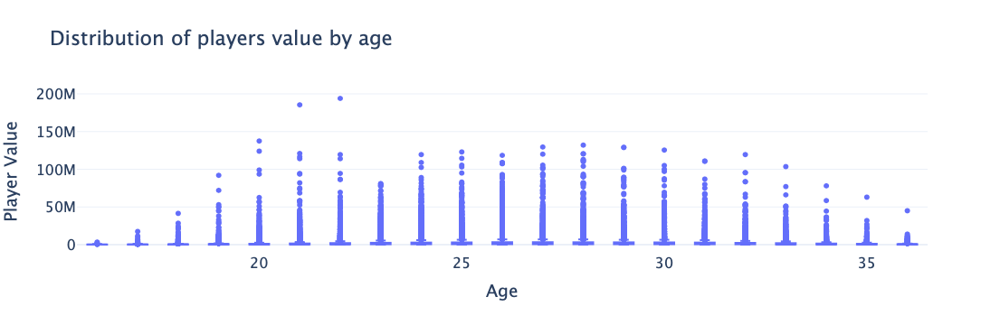

In [22]:
fig = px.box(data, x='age', y=PRICE_COL, title=f"Distribution of players value by age")
fig.update_layout(
    template='plotly_white',
    xaxis_title='Age',
    yaxis_title='Player Value',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
fig.show()

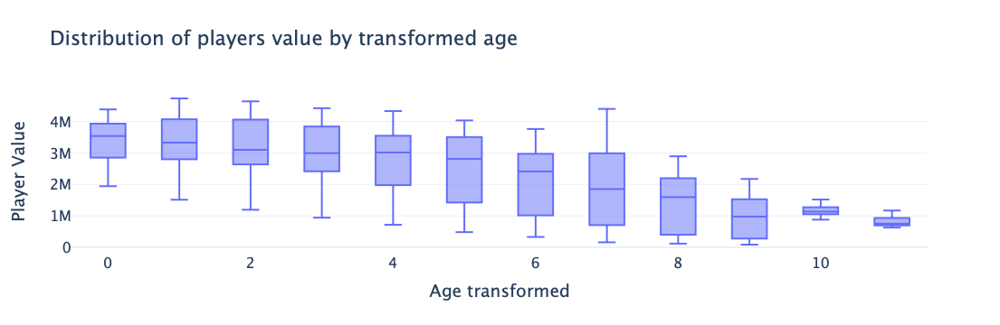

In [23]:
attr_df['age_tran'] = attr_df['age'].apply(lambda x: abs(x-25))
fig = px.box(attr_df, x='age_tran', y='avg_value', 
             title=f"Distribution of players value by transformed age")
fig.update_layout(
    template='plotly_white',
    xaxis_title='Age transformed',
    yaxis_title='Player Value',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
fig.show()

In [24]:
data['age_trans'] = data['age'].apply(lambda x: abs(x-25))
grouped_data = data[['age_trans', 'year', COLUMNS.PLAYER_VALUE]].groupby(by=['year', 'age_trans']).agg(
    [np.size, np.mean, np.median, np.std]).to_dict()
multipliers['age_trans'] = grouped_data

### Real life examples
#### Club coefficient - Barca

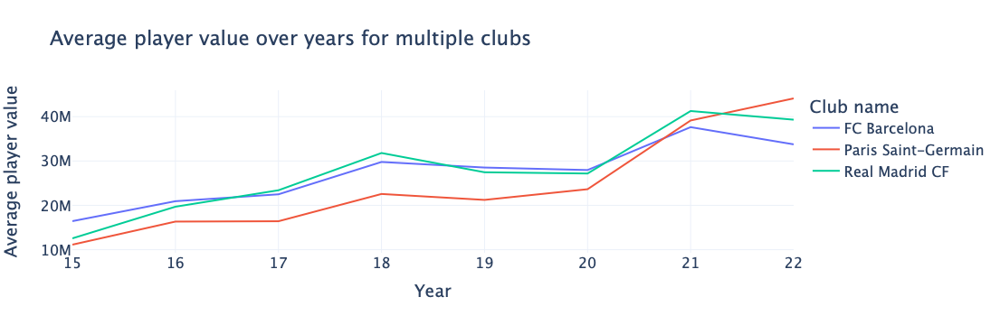

In [25]:
attr = 'club_name'
attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']

# Filter by min count
attr_df = attr_df[attr_df[attr].isin(['Real Madrid CF', 'Paris Saint-Germain', 'FC Barcelona'])]
fig = px.line(attr_df, x='year', y='avg_value', color=attr, title='Average player value over years for multiple clubs',
             )
fig.update_layout(
    template='plotly_white',
    xaxis_title='Year',
    yaxis_title='Average player value',
    legend_title="Club name",
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
fig.show()

#### Club coefficient - of different clubs

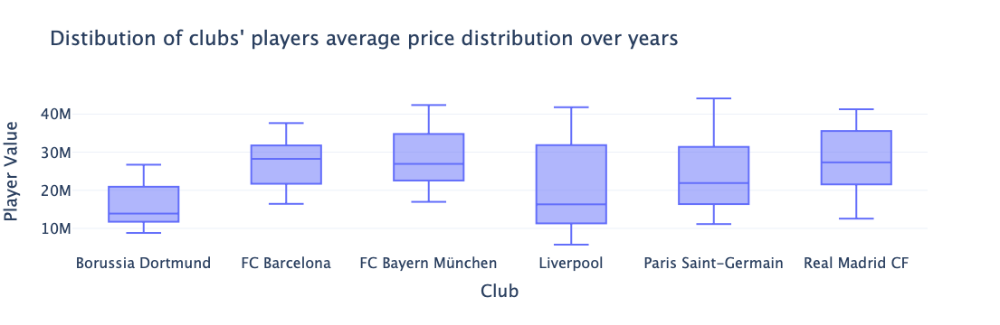

In [26]:
attr = 'club_name'
attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']

# Filter by min count
attr_df = attr_df[attr_df[attr].isin(['Borussia Dortmund', 'FC Bayern München', 'Liverpool', 'Real Madrid CF',
                                     'Paris Saint-Germain', 'FC Barcelona'])]
fig = px.box(attr_df, x=attr, y='avg_value', title=f"Distibution of clubs' players average price distribution over years")
fig.update_layout(
    template='plotly_white',
    xaxis_title='Club',
    yaxis_title='Player Value',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
fig.show()

### League coefficient - 1st place at 2nd bundesliga vs Ligue 1 (FRA)

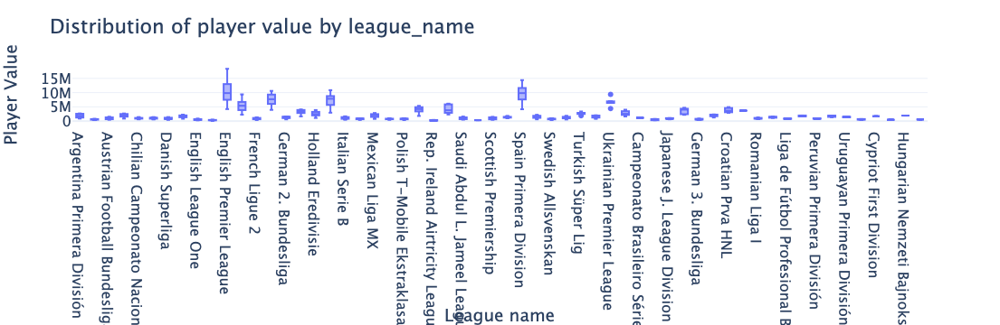

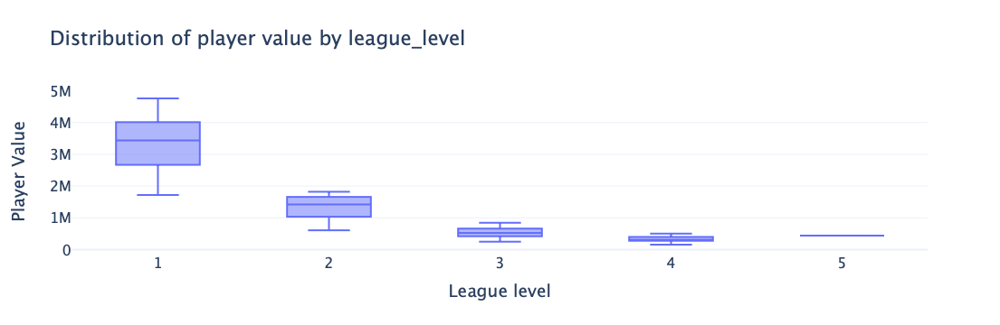

In [27]:
# league_name, league_level
for attr in ['league_name', 'league_level']:
    attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
    attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']
    fig = px.box(attr_df, x=attr, y='avg_value', 
                 title=f'Distribution of player value by {attr}')
    fig.update_layout(
    template='plotly_white',
    xaxis_title=attr.capitalize().replace('_', ' '),
    yaxis_title='Player Value',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
    fig.show()

### Overall and potential

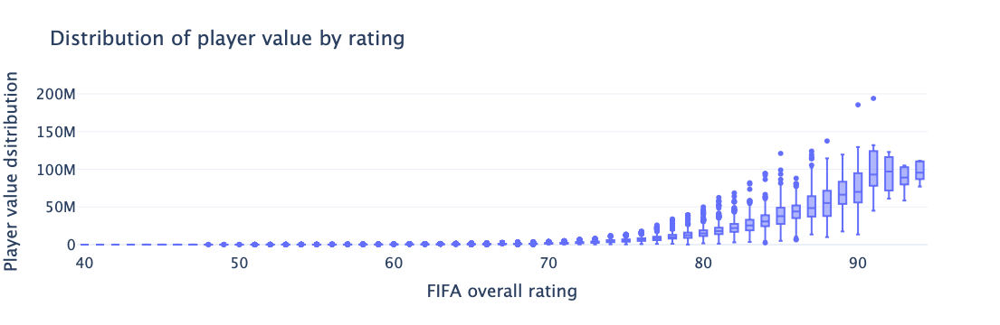

In [28]:
fig = px.box(data, x=COLUMNS.PLAYER_RATING, y=COLUMNS.PLAYER_VALUE, 
             title=f'Distribution of player value by rating')
fig.update_layout(
    template='plotly_white',
    xaxis_title='FIFA overall rating',
    yaxis_title='Player value dsitribution',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
fig.show()

### Overall transfer inflation - trend of team salary
out of budget / average transfer fee this year / average player value in league 

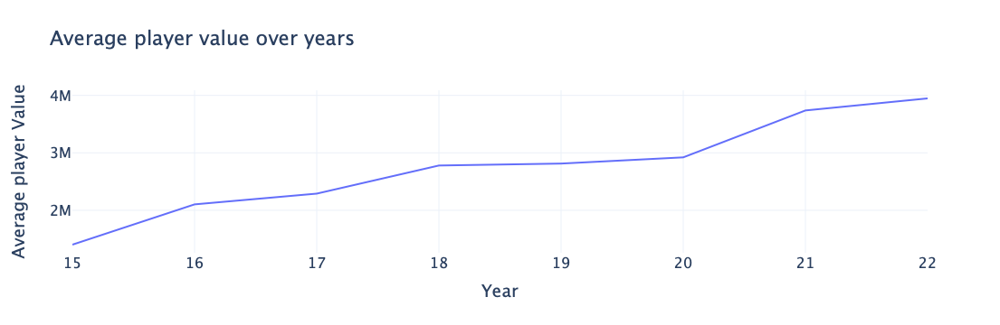

In [30]:
inflation_fig = px.line(pd.DataFrame.from_dict({k: {'year': k, 'value average': v} 
                                          for k,v in global_avg.items()}, orient='index'), 
                        x='year', y='value average',
                        title='Average player value over years')
inflation_fig.update_layout(
    template='plotly_white',
    xaxis_title='Year',
    yaxis_title='Average player Value',
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
inflation_fig.show()

### Events: World cup impact 

/Users/ofirma/anaconda3/envs/fifa/lib/python3.10/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




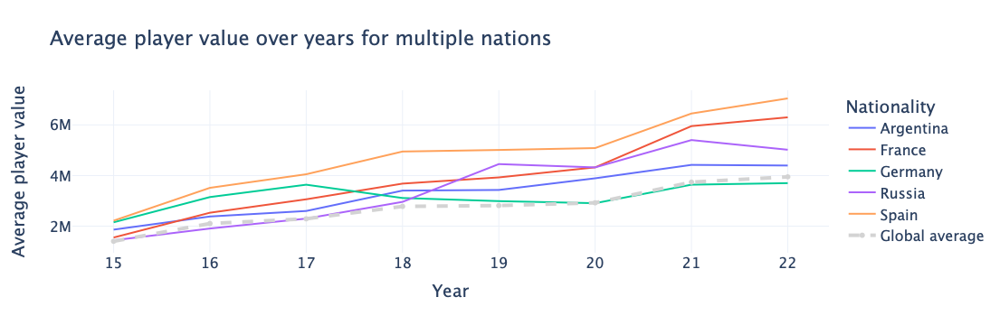

In [31]:
attr = 'nationality_name'
attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']

baseline = pd.DataFrame.from_dict({k: {'year': k, 'value average': v} 
                                          for k,v in global_avg.items()}, orient='index')

# Filter by min count
attr_df = attr_df[attr_df[attr].isin(['France', 'Spain', 'Germany', 'Argentina', 'Russia'])]
wc_fig = px.line(attr_df, x='year', y='avg_value', color=attr, #color_discrete_sequence=["blue", "red", "black", "", ''],
                 title='Average player value over years for multiple nations')
wc_fig.add_trace(go.Line(x=baseline['year'], y=baseline['value average'], name='Global average', 
                         line=dict(color='lightgrey', width=4, dash='dash')))

wc_fig.update_layout(
    template='plotly_white',
    xaxis_title='Year',
    yaxis_title='Average player value',
    legend_title="Nationality",
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
wc_fig.show()

/Users/ofirma/anaconda3/envs/fifa/lib/python3.10/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




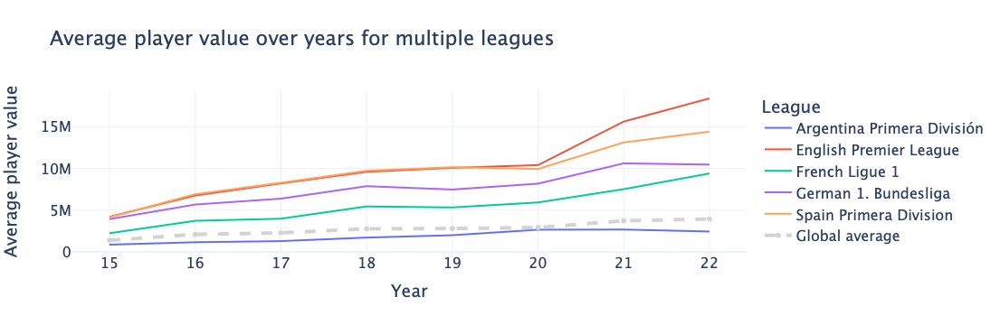

In [32]:
attr = 'league_name'
attr_df = pd.DataFrame(multipliers[attr]).reset_index(drop=False)
attr_df.columns = ['year', attr, 'player_count', 'avg_value', 'median_value', 'std_value']

baseline = pd.DataFrame.from_dict({k: {'year': k, 'value average': v} 
                                          for k,v in global_avg.items()}, orient='index')

# Filter by min count
attr_df = attr_df[attr_df[attr].isin(['French Ligue 1', 'Spain Primera Division', 'German 1. Bundesliga', 
                                      'English Premier League', 'Argentina Primera División'])]
leagues_fig = px.line(attr_df, x='year', y='avg_value', color=attr, #color_discrete_sequence=["blue", "red", "black", "", ''],
                 title='Average player value over years for multiple leagues')
leagues_fig.add_trace(go.Line(x=baseline['year'], y=baseline['value average'], name='Global average', 
                         line=dict(color='lightgrey', width=4, dash='dash')))

leagues_fig.update_layout(
    template='plotly_white',
    xaxis_title='Year',
    yaxis_title='Average player value',
    legend_title="League",
    font=dict(
        family=FONT_FAMILY,
        size=16
    )
)
leagues_fig.show()

## Part 2:Player Valuation Modeling

 - Club coefficient- Eg athletico and Barca - team rating / price multiplier vs rest of clubs in league (if no league - global mean)
 - League coefficient - average team value in league, % of gold players from league
 - Position coefficient
 - Percentile of overall rating and potential
 - Nationality coefficient - how this nationality label mean bigger than general avera

In [33]:
df = data[list(multipliers.keys()) + [PRICE_COL, 'year', COLUMNS.PLAYER_ID, COLUMNS.PLAYER_FULL_NAME]]

In [34]:
df.head(1)

,age,league_name,league_level,club_name,club_position,nationality_name,play_in_based_nation,in_national_team,international_reputation,years_left_in_contract,overall,potential,age_trans,value_eur,year,sofifa_id,long_name
0,35,Belgian Jupiler Pro League,1.0,KAS Eupen,LCM,Spain,0,0,1,1.0,70,70,10,450000.0,17,16.0,Luis García Fernández


### Processing
Calculate the difference of each factor and the global average to build model coeffieients

In [35]:
for c in df.columns:
    if c in multipliers:
        df[f"{c}_mean"] = df.apply(lambda row: multipliers[c][(PRICE_COL, 'mean')].get((row['year'], row[c])), axis=1)
        df[f"{c}_std"] = df.apply(lambda row: multipliers[c][(PRICE_COL, 'std')].get((row['year'], row[c])), axis=1)
        df[f"{c}_diff"] = df.apply(lambda row: row[f"{c}_mean"] - global_avg[row['year']], axis=1)
        df[f"{c}_multiplier"] = df.apply(lambda row: row[f"{c}_mean"] / global_avg[row['year']], axis=1)
df["global_avg"] = df['year'].map(global_avg)

In [36]:
train_set = df[~df[PRICE_COL].isna()].reset_index(drop=False)
test_set = train_set.sample(frac=0.2).reset_index()
test_indices = set(test_set['index'].tolist())
train_set = train_set[~train_set['index'].isin(test_indices)].reset_index()

In [37]:
def analyze_predictions(y_pred, y_true, fig_title: str='Predictions versus truth', hover_data_text: list=None):
    def get_error_bin(error_rate):
        if error_rate <= 0.1:
            return '<=10%'
        elif error_rate <= 0.2:
            return '10-20%'
        elif error_rate <= 0.3:
            return '20-30%'
        elif error_rate <= 0.5:
            return '30-50%'
        else:
            return '>50%'

    pred_df = pd.DataFrame({'pred': y_pred, 'true': y_true})
    pred_df['error'] = pred_df['true'] - pred_df['pred']
    pred_df['abs_error'] = pred_df['error'].apply(abs)
    pred_df['error_rate'] = pred_df['abs_error'] / pred_df['true']
    pred_df['error_bin'] = pred_df['error_rate'].apply(get_error_bin)
    if hover_data_text is not None:
        pred_df['text'] = hover_data_text
        
        scat = px.scatter(pred_df, x='pred', y='true', title=fig_title,
                         color='error_bin', color_discrete_map={
                        '>50%': "red",
                        '20-30%': "yellow",
                        '30-50%': "orange",
                        '10-20%': "lightgreen",
                        '<=10%': "green"},
                         hover_data=["text"],
                         )
    else:
        scat = px.scatter(pred_df, x='pred', y='true', title=fig_title,
                         color='error_bin', color_discrete_map={
                        '>50%': "red",
                        '20-30%': "yellow",
                        '30-50%': "orange",
                        '10-20%': "lightgreen",
                        '<=10%': "green"},
                         )
    scat.update_layout(
                        template='plotly_white',
                        xaxis_title='Predicted player value',
                        yaxis_title='True player value',
                        font=dict(
                            family=FONT_FAMILY,
                            size=16
                        )
                    )
    scat.show()
    
    print('Errors bins counts')
    print(pred_df['error_bin'].value_counts())
    print(pred_df['error_bin'].value_counts() / len(pred_df))
    
    errors_hist = px.histogram(x=pred_df['error'], title='Errors histogram')
    errors_hist.update_layout(
                        template='plotly_white',
                        xaxis_title='Error (millions of Euros)',
                        yaxis_title='Frequency',
                        font=dict(
                            family=FONT_FAMILY,
                            size=16
                        )
                    )
    errors_hist.show()
    return pred_df

In [38]:
MIN_PRED_VAL = 10**5
display_cols = ['long_name', 'year', 'pred', 'true', 'error', 'abs_error', 'error_rate', 'error_bin' ,'age', 
                'league_name', 'club_name', 'club_position', 'nationality_name', 'in_national_team', 
                'international_reputation', 'years_left_in_contract', 'overall', 'potential', 'age_trans', 
                'value_eur', 'global_avg']

### Linear regression

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
modeling_columns: ['global_avg', 'club_name_diff', 'club_position_diff', 'in_national_team_diff', 'years_left_in_contract_diff', 'overall_diff', 'potential_diff', 'age_trans_diff']

Model results:
 - R2 score 0.9529241181569815
 - MAE 560486.4401879436
 - MSE 2148286000811.1523

Model coefffs


,feature,coef
0,global_avg,0.997620
1,club_name_diff,0.004093
2,club_position_diff,0.070434
3,in_national_team_diff,0.030048
4,years_left_in_contract_diff,0.046750
5,overall_diff,0.715676
6,potential_diff,0.372820
7,age_trans_diff,0.859624


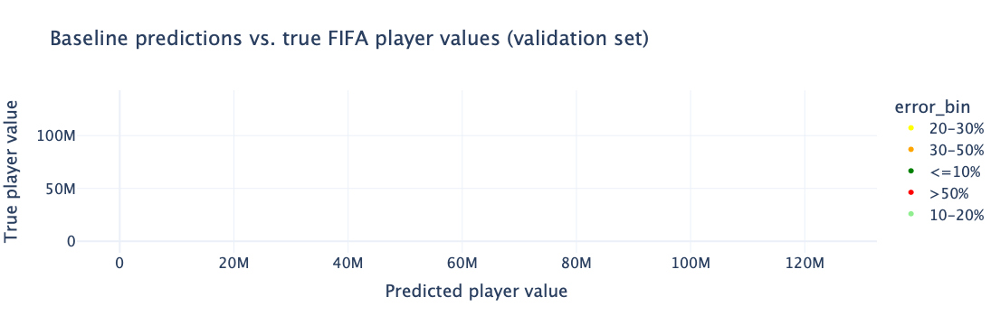

Errors bins counts
error_bin
>50%      6810
<=10%     4778
10-20%    3812
30-50%    3572
20-30%    2516
Name: count, dtype: int64
error_bin
>50%      0.316921
<=10%     0.222357
10-20%    0.177401
30-50%    0.166232
20-30%    0.117089
Name: count, dtype: float64


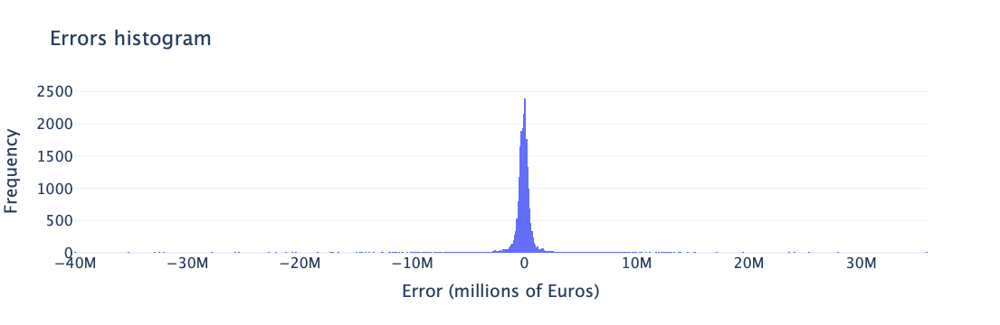

In [39]:
print('-'*200)
modeling_columns = ["global_avg"] + [c for c in df.columns if c.endswith(f"_diff") 
                                     and c not in ['age_diff', 'nationality_name_diff', 
                                                   'league_level_diff', 'league_name_diff', 
                                                   'play_in_based_nation_diff', 'international_reputation_diff']]
print('modeling_columns:', modeling_columns)
X_train = train_set[modeling_columns].copy()
y_train = train_set[PRICE_COL]
X_test = test_set[modeling_columns].copy()
y_test = test_set[PRICE_COL]

X_train.fillna(0, inplace=True)
X_test.fillna(0, inplace=True)

# Fit and predict
lr_model = LinearRegression(positive=True)
y_pred = lr_model.fit(X_train, y_train).predict(X_test)
y_pred = [max(MIN_PRED_VAL, v) for v in y_pred]

# Evaluate
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
print('\nModel results:')
print(" - R2 score", r2)
print(" - MAE", mae)
print(" - MSE", mse)

print('\nModel coefffs')
display(pd.DataFrame({'feature': modeling_columns, 'coef': lr_model.coef_}))

# Analyze predictions
hover_text = [f"{test_set.iloc[i]['long_name']}\n"+
              f"age={test_set.iloc[i]['age']}, year={test_set.iloc[i]['year']})"+
              f"\nOverall={test_set.iloc[i][COLUMNS.PLAYER_RATING]}, Potential={test_set.iloc[i]['potential']}" 
              for i in range(len(test_set))]
pred_df = analyze_predictions(y_pred, y_test, hover_data_text=hover_text,
                             fig_title='Baseline predictions vs. true FIFA player values (validation set)')

### Sub cases - under / over 10m
This block was commented as it is identical to the last one (but for the test set) and this file was too heavy for GitHub.

In [40]:
# over_indices = y_test > 5 * 10 ** 6
# over_test = X_test.reset_index(drop=True)[over_indices].reset_index()
# over_test_labels = y_test[over_indices]
# over_preds = lr_model.predict(over_test[X_test.columns].fillna(0))
# over_preds = [max(MIN_PRED_VAL, v) for v in over_preds]
# print('over 5m')
# r2 = r2_score(over_test_labels, over_preds)
# mae = mean_absolute_error(over_test_labels, over_preds)
# mse = mean_squared_error(over_test_labels, over_preds)
# print(" - R2 score", r2)
# print(" - MAE", mae)
# print(" - MSE", mse)
# analyze_predictions(over_preds, over_test_labels, fig_title='Baseline predictions vs. true FIFA player values (over 5M Euros)',
#                    hover_data_text=pd.Series(hover_text)[over_indices].tolist())

# under_test = X_test.reset_index(drop=True)[~over_indices].reset_index()
# under_test_labels = y_test[~over_indices]
# under_preds = lr_model.predict(under_test[X_test.columns].fillna(0))
# under_preds = [max(MIN_PRED_VAL, v) for v in under_preds]
# print('\nunder 5m')
# r2 = r2_score(under_test_labels, under_preds)
# mae = mean_absolute_error(under_test_labels, under_preds)
# mse = mean_squared_error(under_test_labels, under_preds)
# print(" - R2 score", r2)
# print(" - MAE", mae)
# print(" - MSE", mse)
# res_df = analyze_predictions(under_preds, under_test_labels, 
#                     hover_data_text=pd.Series(hover_text)[~over_indices].tolist(), 
#                     fig_title = 'Baseline predictions vs. true FIFA player values (under 5M Euros)')

### Predicting 2022

In [41]:
data_2022['age_trans'] = data_2022['age'].apply(lambda x: abs(x-25))
df_22 = data_2022[list(multipliers.keys()) + [PRICE_COL, 'year', COLUMNS.PLAYER_ID, COLUMNS.PLAYER_FULL_NAME]]
for c in df_22.columns:
    if c in multipliers:
        df_22[f"{c}_mean"] = df_22.apply(lambda row: multipliers[c][(PRICE_COL, 'mean')].get((21, row[c])), axis=1)
        df_22[f"{c}_std"] = df_22.apply(lambda row: multipliers[c][(PRICE_COL, 'std')].get((21, row[c])), axis=1)
        df_22[f"{c}_diff"] = df_22.apply(lambda row: row[f"{c}_mean"] - global_avg[21], axis=1)
        df_22[f"{c}_multiplier"] = df_22.apply(lambda row: row[f"{c}_mean"] / global_avg[21], axis=1)
df_22["global_avg"] = df_22['year'].map(global_avg)

In [42]:
label_22_dict = data.loc[data['year']==22, [COLUMNS.PLAYER_ID, PRICE_COL]].set_index(COLUMNS.PLAYER_ID).to_dict()

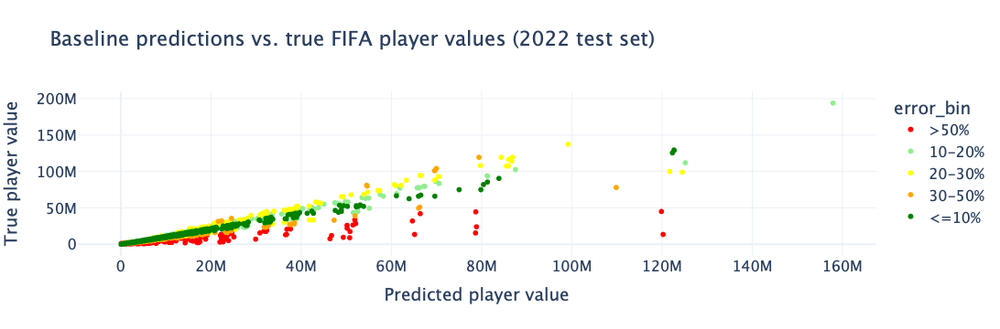

Errors bins counts
error_bin
>50%      3046
<=10%     2779
10-20%    2407
30-50%    2161
20-30%    1782
Name: count, dtype: int64
error_bin
>50%      0.250185
<=10%     0.228255
10-20%    0.197700
30-50%    0.177495
20-30%    0.146366
Name: count, dtype: float64


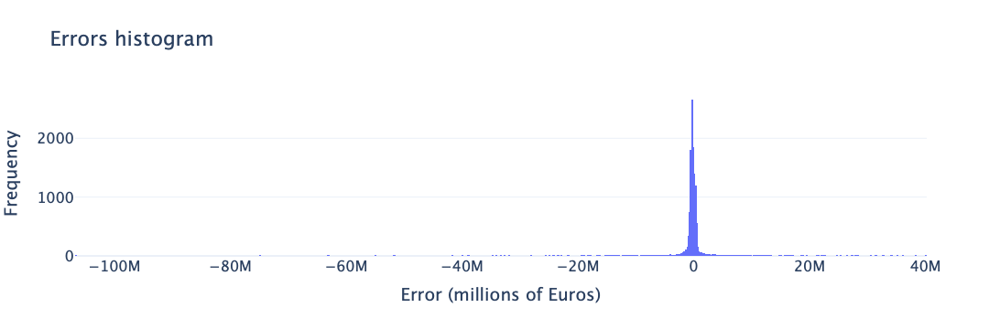


2022 Model results:
 - R2 score 0.9072579136946859
 - MAE 836038.7737732694
 - MSE 7990604314946.999


In [43]:
y_22 = df_22[PRICE_COL]
X_22 = df_22.loc[y_22.notna(), modeling_columns].reset_index(drop=True)
y_22 = y_22[y_22.notna()].reset_index(drop=True)
X_22.fillna(0, inplace=True)

y_pred = lr_model.predict(X_22)
y_pred = list(y_pred)
for i, (pred, pred_player) in enumerate(zip(y_pred, df_22[COLUMNS.PLAYER_ID].tolist())):
    # Override prediction with last year price if < 0
    if pred < MIN_PRED_VAL:
        y_pred[i] = label_22_dict.get(pred_player, MIN_PRED_VAL)
pred_df_22 = analyze_predictions(y_pred, y_22, 
                                 fig_title='Baseline predictions vs. true FIFA player values (2022 test set)')

# Evaluate
r2 = r2_score(y_22, y_pred)
mae = mean_absolute_error(y_22, y_pred)
mse = mean_squared_error(y_22, y_pred)
print('\n2022 Model results:')
print(" - R2 score", r2)
print(" - MAE", mae)
print(" - MSE", mse)

# Styling
pred_df_22['ix'] = list(range(len(pred_df_22)))
for col in ['true', 'pred', 'error', 'abs_error']:
    pred_df_22[col] = pred_df_22[col].astype(float).apply(lambda x: "€{:.1f}M".format(x/1000000))

### Threshold 5M split

over 10m


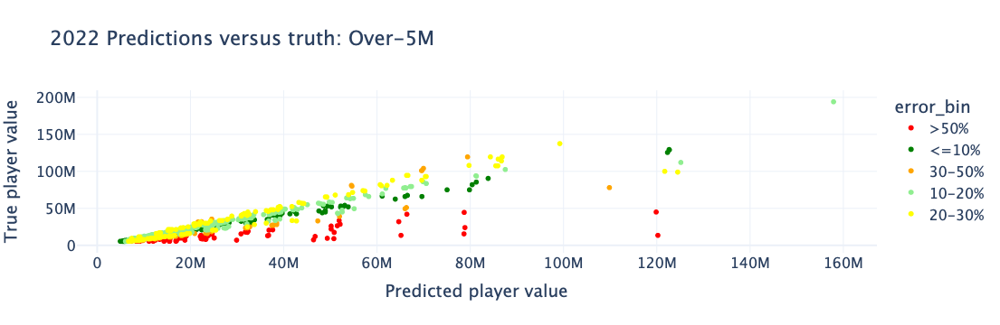

Errors bins counts
error_bin
<=10%     971
10-20%    509
20-30%    170
>50%      101
30-50%     79
Name: count, dtype: int64
error_bin
<=10%     0.530601
10-20%    0.278142
20-30%    0.092896
>50%      0.055191
30-50%    0.043169
Name: count, dtype: float64


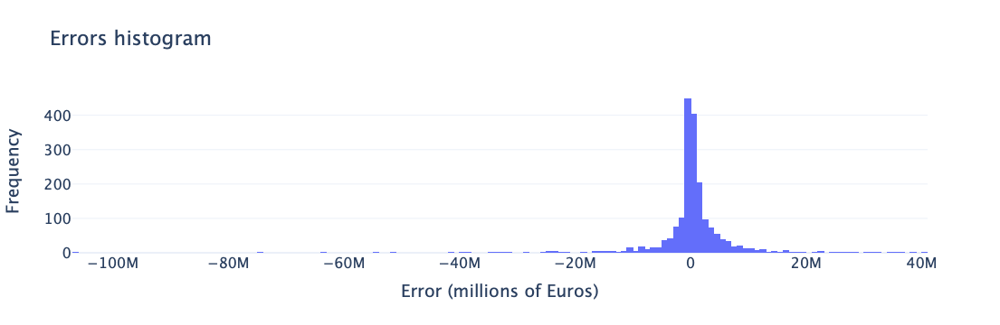


under 10m


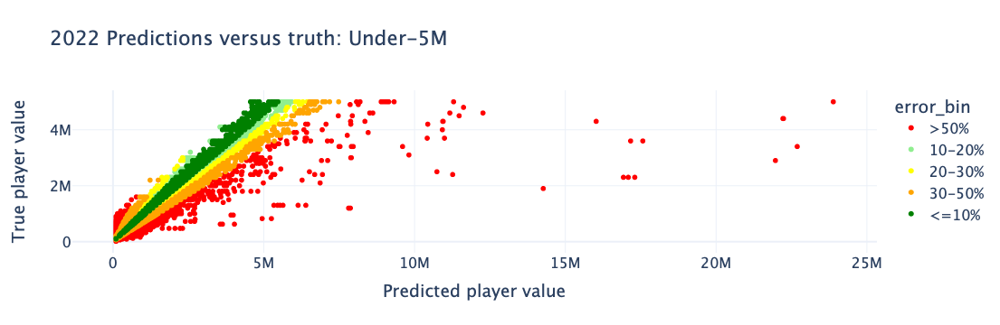

Errors bins counts
error_bin
>50%      2945
30-50%    2082
10-20%    1898
<=10%     1808
20-30%    1612
Name: count, dtype: int64
error_bin
>50%      0.284679
30-50%    0.201257
10-20%    0.183470
<=10%     0.174770
20-30%    0.155824
Name: count, dtype: float64


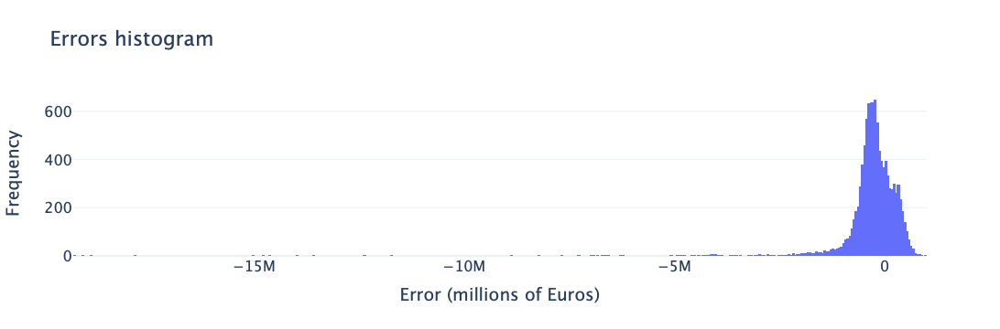

In [44]:
# Under / over 5m analysis
# Over
over_indices = y_22.reset_index(drop=True) > 5 * 10 ** 6
over_test = X_22.reset_index(drop=True)[over_indices].reset_index()
over_test_labels = y_22[over_indices]
over_preds = lr_model.predict(over_test[X_22.columns].fillna(0))
over_preds = [max(MIN_PRED_VAL, v) for v in over_preds]
print('over 10m')
res_df = analyze_predictions(over_preds, over_test_labels, fig_title='2022 Predictions versus truth: Over-5M')

# Under
under_test = X_22.reset_index(drop=True)[~over_indices].reset_index()
under_test_labels = y_22[~over_indices]
under_preds = lr_model.predict(under_test[X_22.columns].fillna(0))
under_preds = [max(MIN_PRED_VAL, v) for v in under_preds]
print('\nunder 10m')
res_df = analyze_predictions(under_preds, under_test_labels, fig_title = '2022 Predictions versus truth: Under-5M')